## **Reverse Image Search - Baseline (30 points)**



1.   We've developed Reverse Image Search baseline performance by using pre-trained models like ResNet, VGG, etc.
2.   These models were used to extract features of the entire training dataset (13223 images, 5749 classes).
3.   The features/embeddings were then stored in drive so that we could use it later for similarity search. We store all the intermediate and training files in the drive itself.
4.   For testing, we can retrive embeddings of any of these pre-trained models. With nearest neighbors algorithm, we find the closest images for a particular query image 



### **Setup**

In [ ]:
#Face detection using MTCNN
!pip install mtcnn
!pip install git+https://github.com/rcmalli/keras-vggface.git
!pip install keras_applications
!pip install faiss-gpu
filename = "/usr/local/lib/python3.7/dist-packages/keras_vggface/models.py"
text = open(filename).read()
open(filename, "w+").write(text.replace('keras.engine.topology', 'tensorflow.keras.utils'))
import mtcnn
from PIL import Image
import numpy as np
from numpy.linalg import norm
import pickle
from tqdm import tqdm, tqdm_notebook
import os
import random
import time
import math
import tensorflow
import tarfile
from sklearn.neighbors import NearestNeighbors
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.mobilenet import MobileNet
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.applications.xception import Xception
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Flatten, Dense, Dropout, GlobalAveragePooling2D
from sklearn.decomposition import PCA
from sklearn.neighbors import KNeighborsClassifier
from keras.models import load_model
from keras_vggface.vggface import VGGFace
from sklearn.neighbors import KNeighborsClassifier
import faiss

     |████████████████████████████████| 2.3 MB 16.8 MB/s 
  Cloning https://github.com/rcmalli/keras-vggface.git to /tmp/pip-req-build-rbg8qpmw
  Running command git clone -q https://github.com/rcmalli/keras-vggface.git /tmp/pip-req-build-rbg8qpmw
  Created wheel for keras-vggface: filename=keras_vggface-0.6-py3-none-any.whl size=8325 sha256=312765d5624548a05134d7ff6af0745aa761dc4b7202e910982ab3b12a445cbb
  Stored in directory: /tmp/pip-ephem-wheel-cache-w0vlf68y/wheels/08/df/86/0225d44647ab2256dbf1e006823288fe9cc86367a056e6ea2c
Successfully built keras-vggface
     |████████████████████████████████| 50 kB 6.2 MB/s 


### **Model Picker**


1.   Before performing reverse image search, we need to either build a model which recognizes facial features or use a pre-trained model.
2.   So, we moved forward with pre-trained models to see how they perform.
3.   We defined a very simple function which returns the specified model.
4. For Baseline, we've used ResNet50, VGG16, Inception, Xception and mobilenet.



In [ ]:
TRAIN_SAMPLES = 13233
IMG_WIDTH, IMG_HEIGHT = 224, 224
NUM_CLASSES = 5749
'''
We have set total number of neighbors to 5. Every class has maximum 
6 training images. Also, we are calculating accuracy with respect to 
how many correct and incorrect predictions we get per query image.
'''
number_of_neighbors = 5
def model_picker(name):
    if (name == 'vgg16'):
        model = VGG16(weights='imagenet',
                      include_top=False,
                      input_shape=(IMG_WIDTH, IMG_HEIGHT, 3),
                      pooling='max')
    elif (name == 'mobilenet'):
        model = MobileNet(weights='imagenet',
                          include_top=False,
                          input_shape=(IMG_WIDTH, IMG_HEIGHT, 3),
                          pooling='max',
                          depth_multiplier=1,
                          alpha=1)
    elif (name == 'inception'):
        model = InceptionV3(weights='imagenet',
                            include_top=False,
                            input_shape=(IMG_WIDTH, IMG_HEIGHT, 3),
                            pooling='max')
    elif (name == 'resnet'):
        model = ResNet50(weights='imagenet',
                         include_top=False,
                         input_shape=(IMG_WIDTH, IMG_HEIGHT, 3),
                        pooling='max')
    elif (name == 'xception'):
        model = Xception(weights='imagenet',
                         include_top=False,
                         input_shape=(IMG_WIDTH, IMG_HEIGHT, 3),
                         pooling='max')
    elif (name == 'facenet'):
        model = load_model('drive/MyDrive/all_trained_models/facenet_keras.h5')
    elif (name == 'vggface'):
        model = VGGFace(model='resnet50', include_top=False, input_shape=(IMG_WIDTH, IMG_HEIGHT, 3), pooling='avg')
    else:
        print("Specified model not available")
    return model

In [ ]:
model_architecture = 'facenet'
model = model_picker(model_architecture)

### **File List Reader**



1.   A simple function to retrieve all files present in a specific directory.
2.   LFW dataset folder has subfolders with respect to celebrities. Every subfolder consists images for training purposes.
3.   As we are interested with images, we keep track of all it in file_list variable.
4.   Training class labels are stored in directory_names variable.



In [ ]:
extensions = ['.jpg', '.JPG', '.jpeg', '.JPEG', '.png', '.PNG']
    
def get_file_list(root_dir):
    file_list = []
    directory_names = []
    for root, directories, filenames in os.walk(root_dir):
        for filename in filenames:
            # Only consider images
            if any(ext in filename for ext in extensions):
                filepath = os.path.join(root, filename)
                if os.path.exists(filepath):
                  # Image for Training
                  file_list.append(filepath)
                  # Celebrity name (Labels)
                  directory_names.append(root.split('/')[-1])
                else:
                  print(filepath)
    return file_list, directory_names

### **Extract Features**

1.   This function extracts relevant features for a particular image using the pre-trained model.



In [ ]:
def extract_features(img_path, model):
    input_shape = (IMG_WIDTH, IMG_HEIGHT, 3)
    img = image.load_img(img_path,
                         target_size=(input_shape[0], input_shape[1]))
    img_array = image.img_to_array(img)
    expanded_img_array = np.expand_dims(img_array, axis=0)
    preprocessed_img = preprocess_input(expanded_img_array)
    features = model.predict(preprocessed_img)
    flattened_features = features.flatten()
    normalized_features = flattened_features / norm(flattened_features)
    return normalized_features

In [ ]:
def save_features(features_list, filename):
  pickle.dump(features_list, open(filename, 'wb'))

In [ ]:
def read_all_files():
  file_list = []
  directory_names = []
  standard_feature_list = []
  with open('drive/MyDrive/all_trained_models/filenames.pickle', 'rb') as f:
    file_list = pickle.load(f)
  print(len(file_list))
  with open('drive/MyDrive/all_trained_models/classes.pickle', 'rb') as f:
    directory_names = pickle.load(f)
  with open('drive/MyDrive/all_trained_models/features-' + model_architecture +'.pickle', 'rb') as f:
    standard_feature_list = pickle.load(f)
  return file_list, directory_names, standard_feature_list
file_list, directory_names, standard_feature_list = read_all_files()

13233


### **Feature Extraction**

In [ ]:
for i in tqdm_notebook(range(len(file_list))):
    standard_feature_list.append(extract_features(file_list[i], model))
save_features(standard_feature_list, 'drive/MyDrive/all_trained_models/features-' + model_architecture +'.pickle')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  """Entry point for launching an IPython kernel.


  0%|          | 0/13233 [00:00<?, ?it/s]

### **Similarity Search**


1.   Extracted features and corresponding training labels would be fit into a similarity search algorithm.
2.   We are using NearestNeighbors classifier which is an unsupervised nearest neighbors learning.
3.   It acts as a uniform interface to three different nearest neighbors algorithms: BallTree, KDTree, and a brute-force algorithm.



In [ ]:
neighbors = NearestNeighbors(n_neighbors=number_of_neighbors,
                             algorithm='brute',
                             metric='euclidean').fit(standard_feature_list, directory_names)

In [ ]:
# Helper function to get the classname
def classname(str):
    return str.split('/')[-2]


# Helper function to get the classname and filename
def classname_filename(str):
    return str.split('/')[-2] + '/' + str.split('/')[-1]


# Helper functions to plot the nearest images given a query image
def plot_images(filenames, distances):
    images = []
    for filename in filenames:
        images.append(mpimg.imread(filename))
    plt.figure(figsize=(20, 10))
    columns = 5
    for i, image in enumerate(images):
        ax = plt.subplot(len(images) / columns + 1, columns, i + 1)
        if i == 0:
            ax.set_title("Query Image\n" + classname_filename(filenames[i]))
        else:
            ax.set_title("Similar Image\n" + classname_filename(filenames[i]) +
                         "\nDistance: " +
                         str(float("{0:.2f}".format(distances[i]))))
        plt.imshow(image)

### **Testing**


1.   Now we perform testing on 10 query images.
2.   For every query image, we perform the smae steps as before.
3.   Extract features and use these to predict labels using similarity search algorithm.



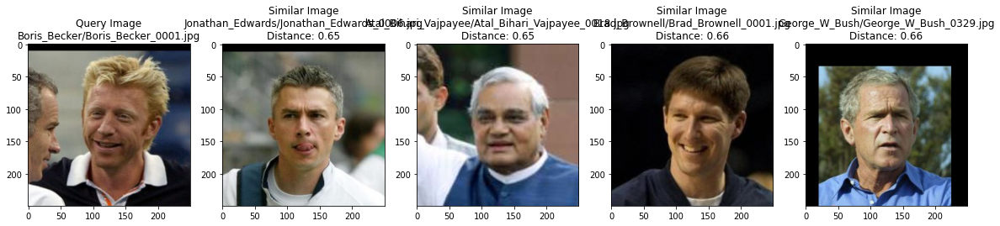

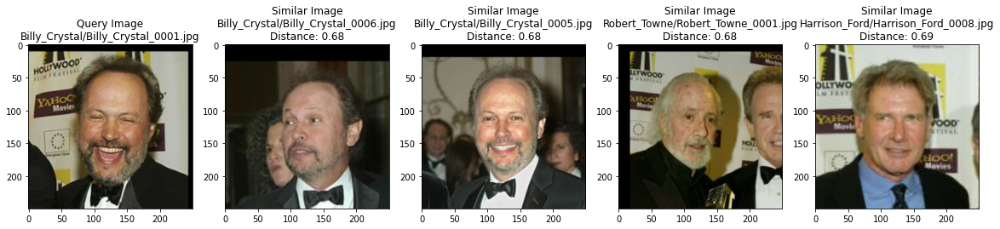

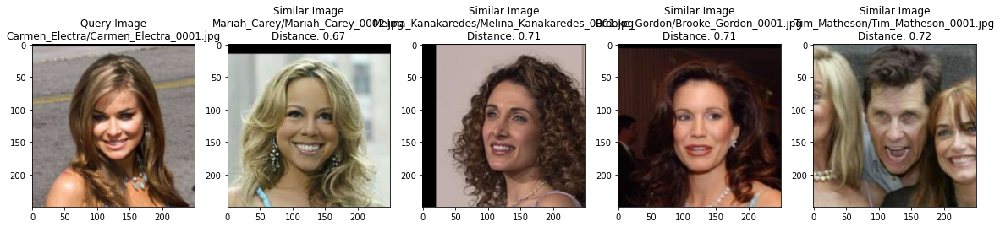

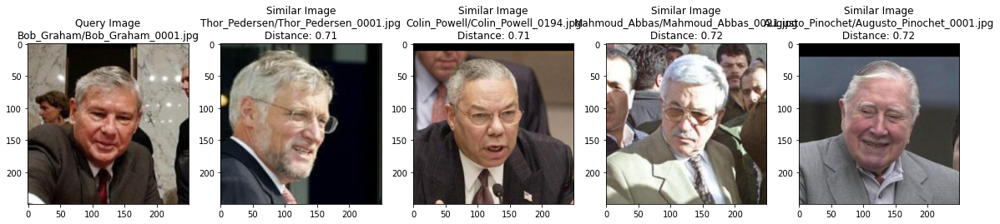

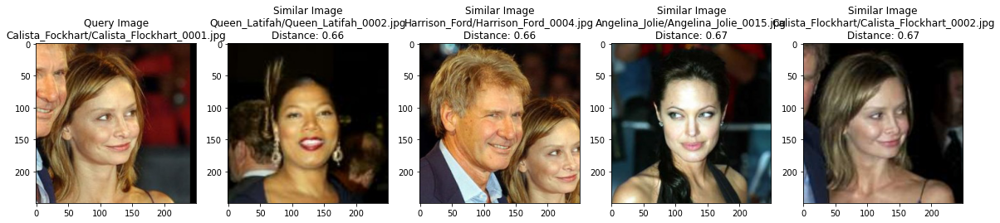

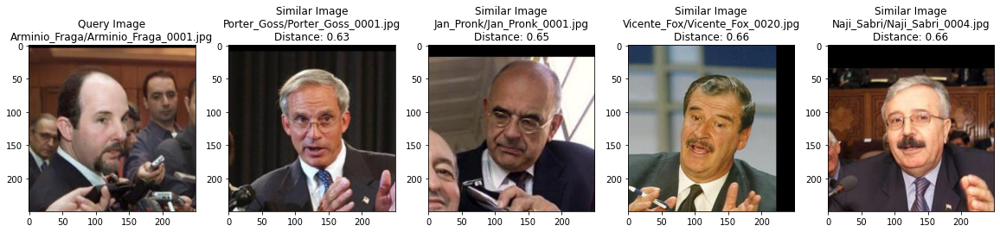

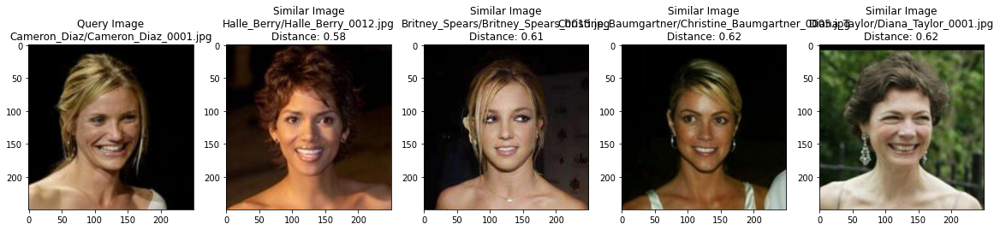

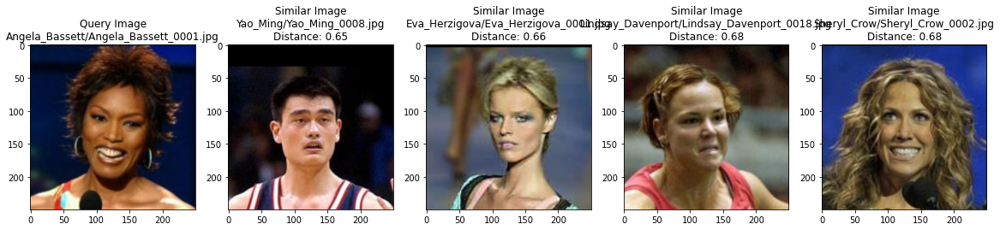

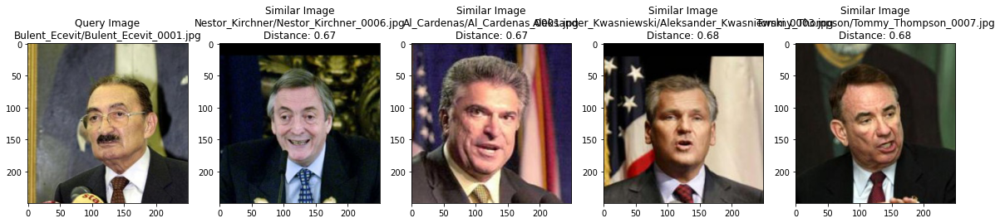

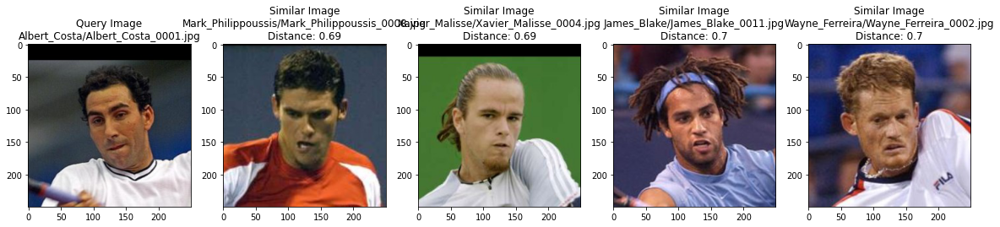

In [ ]:
test_file_list, test_labels = get_file_list('drive/MyDrive/testqueries/')
for i in range(len(test_file_list)):
    test_feature = extract_features(test_file_list[i], model)
    distances, indices = neighbors.kneighbors([test_feature])
    similar_image_paths = [test_file_list[i]] + \
                    [file_list[indices[0][j]] for j in range(1, 5)]
    plot_images(similar_image_paths, distances[0])

### **Accuracy**

1.   For accuracy calculation, we went with considering this as a typical classification.
2.   We check for each query image, how many neighbors predicted are correctly and incorrectly tagged.
3.   With this, we can identify the accuracy levels. 



In [ ]:
def calculate_accuracy():
    correct_predictions = 0
    incorrect_predictions = 0
    for i in range(len(test_file_list)):
        test_feature = extract_features(test_file_list[i], model)
        distances, indices = neighbors.kneighbors([test_feature])
        
        for j in range(0, number_of_neighbors):
            if (test_labels[i] == classname(
                    file_list[indices[0][j]])):
                correct_predictions += 1
            else:
                incorrect_predictions += 1
    print(
        "Accuracy is ",
        round(
            100.0 * correct_predictions /
            (1.0 * correct_predictions + incorrect_predictions), 2))

In [ ]:
calculate_accuracy()

Accuracy is  22.0


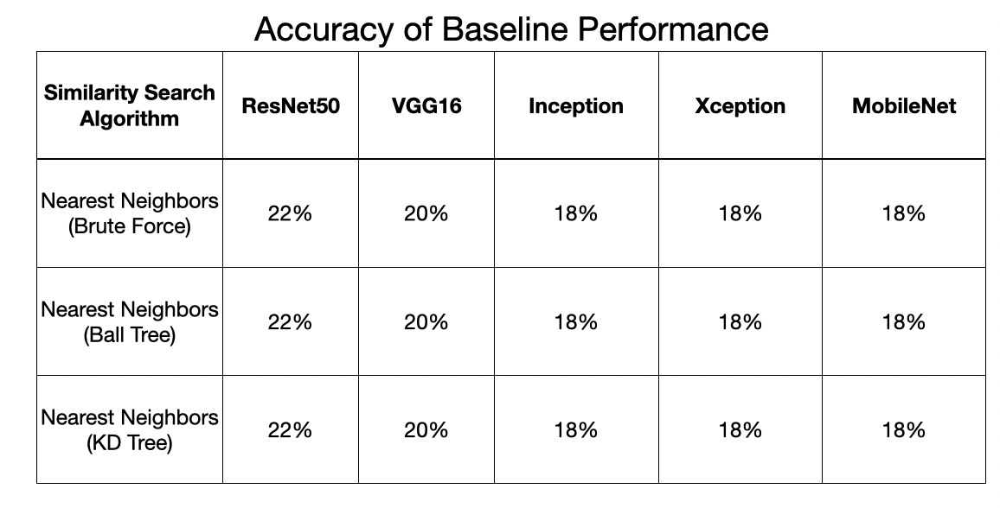

## **Reverse Image Search Improvement (30 points)**


1.   As an improvement to the baseline, since the accuracy is pretty low we've tried two improvements
2.   One being face cropping faces and using it for extracting features. This helps in avoiding extracting irrelevant features from the images.
3.   Secondly, We've used much more sophisticated models like FaceNet, DeepFace and VGGFace + ResNet50.
4.   The only model which provided with better accuracy was FaceNet. Other models couldn't scale up.
5.   We also tried checking if dimensionality reduction using PCA would improve accuracy. But the accuracy remained pretty much the same.



### **Cropping faces from the LFW dataset**

In [ ]:
def extract_face(filename, required_size=(160, 160)):
	# load image from file
	image = Image.open(filename)
	# convert to RGB, if needed
	image = image.convert('RGB')
	# convert to array
	pixels = np.asarray(image)
	# create the detector, using default weights
	detector = mtcnn.MTCNN()
	# detect faces in the image
	results = detector.detect_faces(pixels)
	# extract the bounding box from the first face
	x1, y1, width, height = results[0]['box']
	# bug fix
	x1, y1 = abs(x1), abs(y1)
	x2, y2 = x1 + width, y1 + height
	# extract the face
	face = pixels[y1:y2, x1:x2]
	# resize pixels to the model size
	image = Image.fromarray(face)
	image = image.resize(required_size)
	face_array = np.asarray(image)
	return face_array

### **Retrieve embeddings for cropped images**

In [ ]:
# get the face embedding for one face
def get_embedding(model, face_pixels):
	# scale pixel values
	face_pixels = face_pixels.astype('float32')
	# standardize pixel values across channels (global)
	mean, std = face_pixels.mean(), face_pixels.std()
	face_pixels = (face_pixels - mean) / std
	# transform face into one sample
	samples = np.expand_dims(face_pixels, axis=0)
	# make prediction to get embedding
	yhat = model.predict(samples)
	return yhat[0]

### **FaceNet Model**

In [ ]:
newTrainX = []
for i in tqdm_notebook(range(len(file_list))):
  detected_faces = extract_face(file_list[i])
  embedding = get_embedding(model, detected_faces)
  newTrainX.append(embedding)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  after removing the cwd from sys.path.


  0%|          | 0/13233 [00:00<?, ?it/s]

### **Similarity Search : NearestNeighbors**

In [ ]:
newTrainX = standard_feature_list
neighbors = NearestNeighbors(n_neighbors=number_of_neighbors,
                             algorithm='kd_tree',
                             metric='euclidean').fit(newTrainX, directory_names)

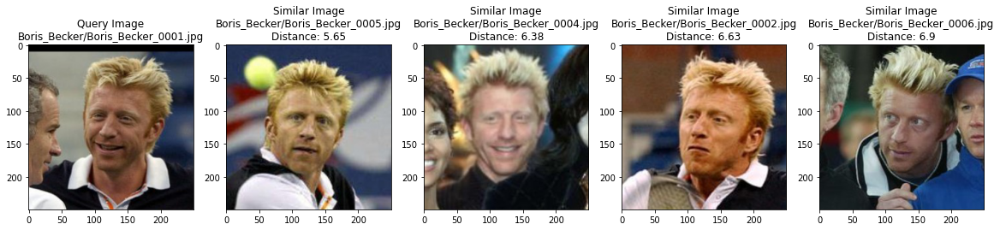

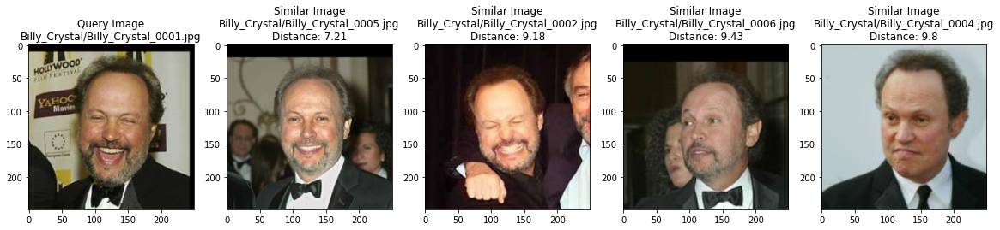

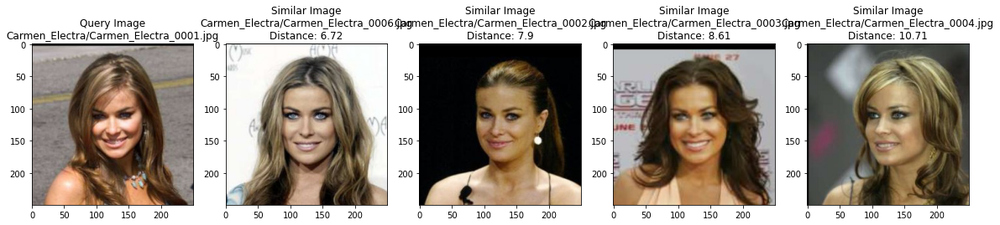

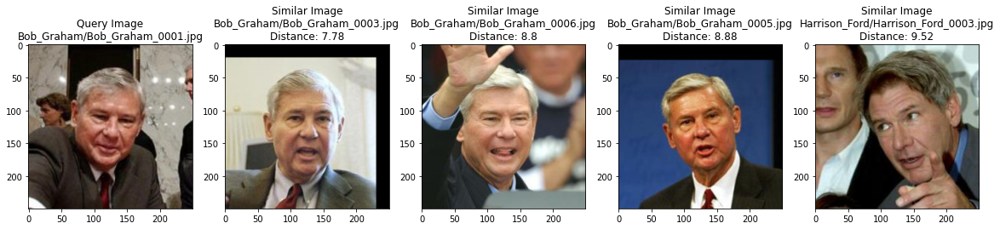

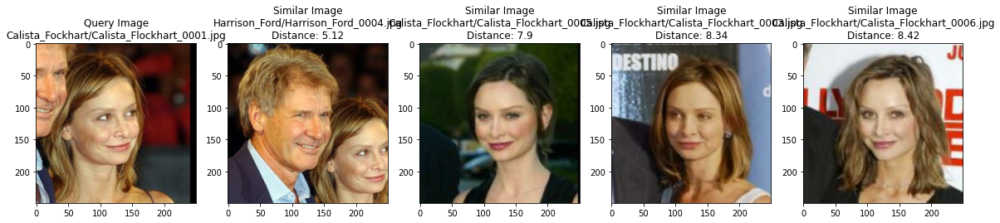

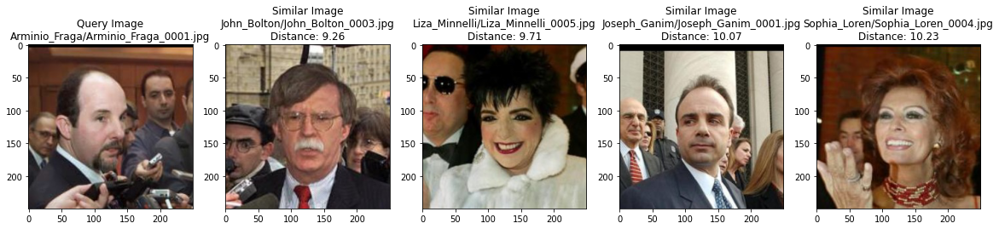

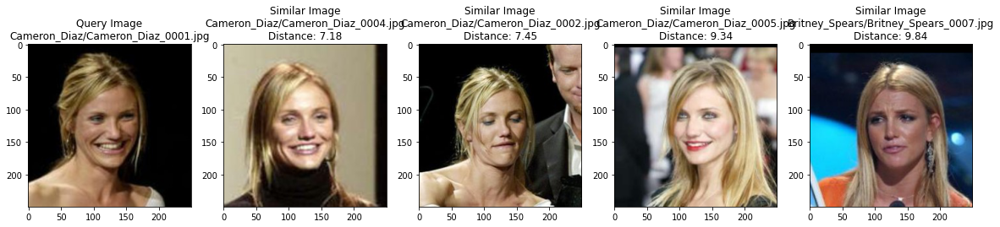

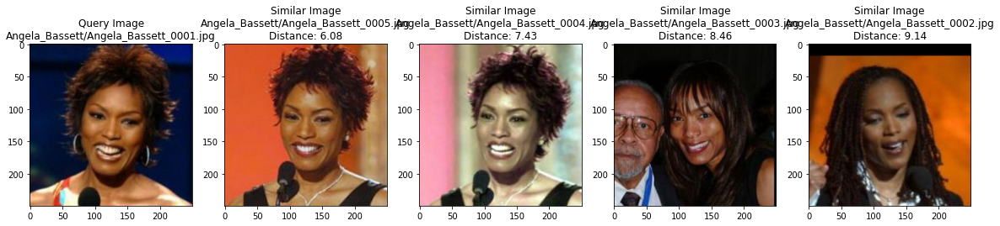

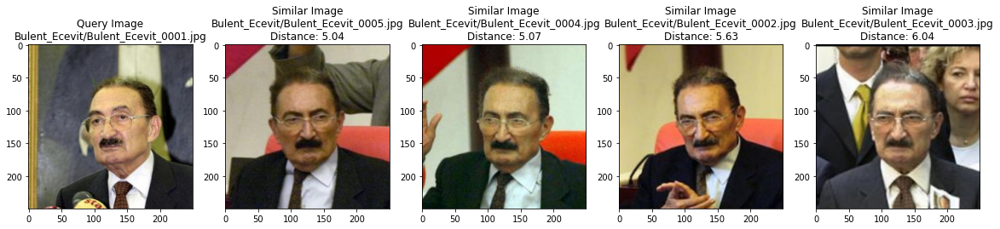

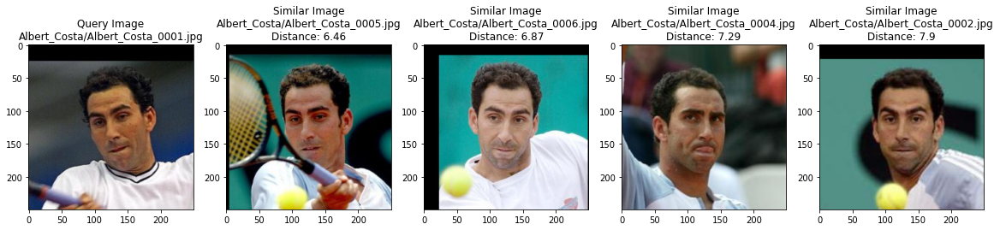

In [ ]:
test_file_list, test_labels = get_file_list('drive/MyDrive/testqueries/')
for i in range(len(test_file_list)):
    detected_faces = extract_face(test_file_list[i])
    embedding = get_embedding(model, detected_faces)
    distances, indices = neighbors.kneighbors([embedding])
    similar_image_paths = [test_file_list[i]] + \
                    [file_list[indices[0][j]] for j in range(1, 5)]
    plot_images(similar_image_paths, distances[0])

In [ ]:
def calculate_accuracy_for_facenet():
    incorrect_predictions = 0
    correct_predictions = 0
    for i in range(len(test_file_list)):
        detected_faces = extract_face(test_file_list[i])
        embedding = get_embedding(model, detected_faces)
        distances, indices = neighbors.kneighbors([embedding])
        
        for j in range(0, number_of_neighbors):
            if (test_labels[i] == classname(
                    file_list[indices[0][j]])):
                correct_predictions += 1
            else:
                incorrect_predictions += 1
    print(
        "Accuracy is ",
        round(
            100.0 * correct_predictions /
            (1.0 * correct_predictions + incorrect_predictions), 2))

In [ ]:
calculate_accuracy_for_facenet()

Accuracy is  78.0


### **Similarity Search : Scikit Learn**

In [ ]:
pca = PCA(n_components=128)
pca.fit(newTrainX)
feature_list_compressed = pca.transform(newTrainX)
feature_list_compressed = feature_list_compressed.tolist()
pcaneighbors = NearestNeighbors(n_neighbors=number_of_neighbors,
                             algorithm='ball_tree',
                             metric='euclidean').fit(feature_list_compressed, directory_names)

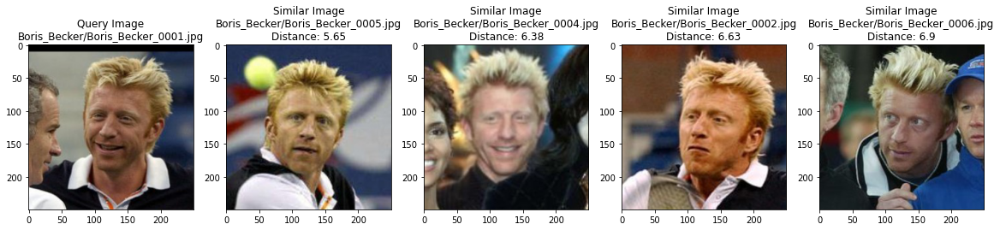

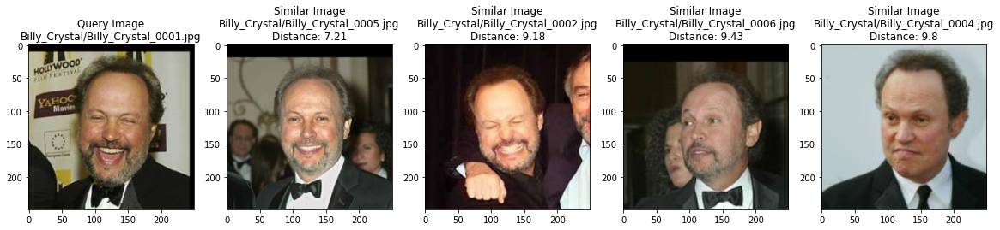

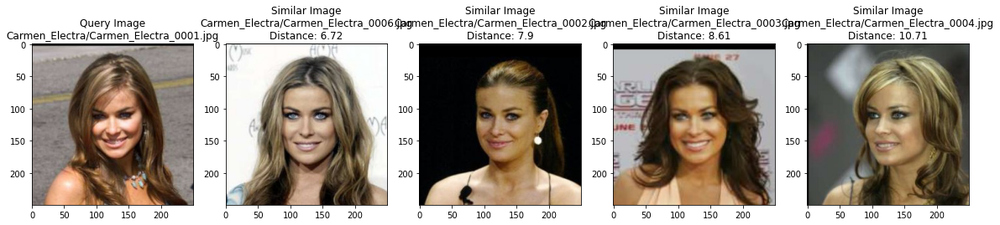

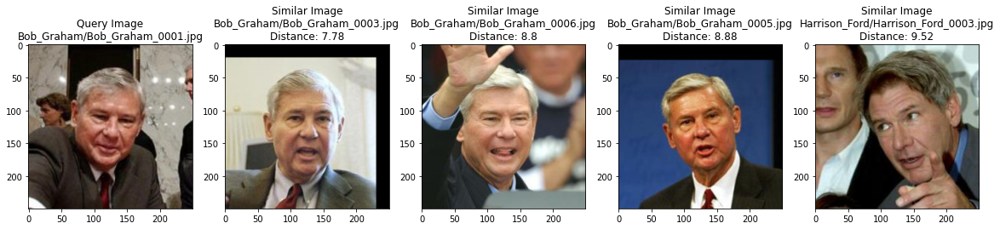

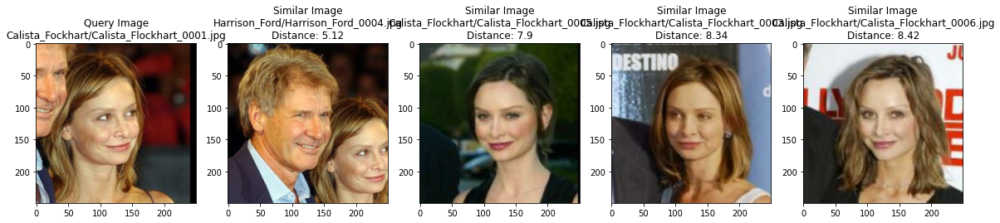

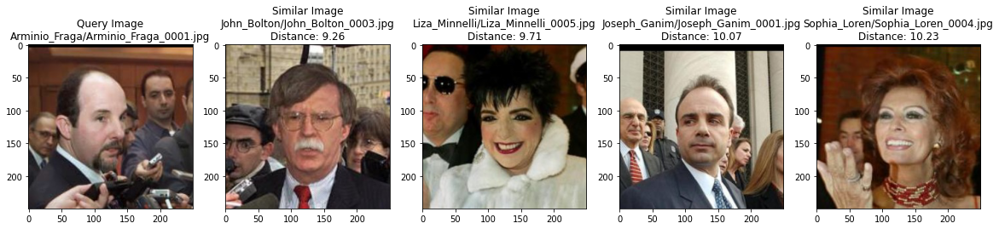

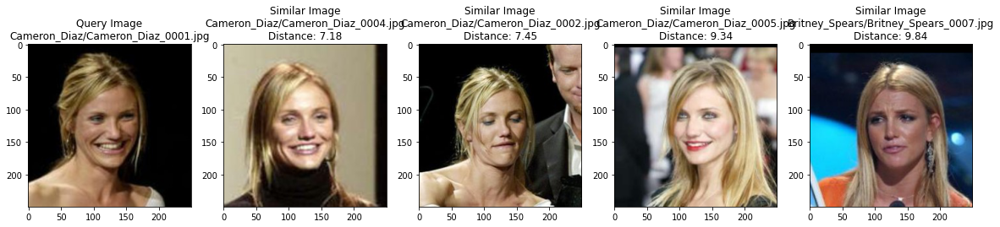

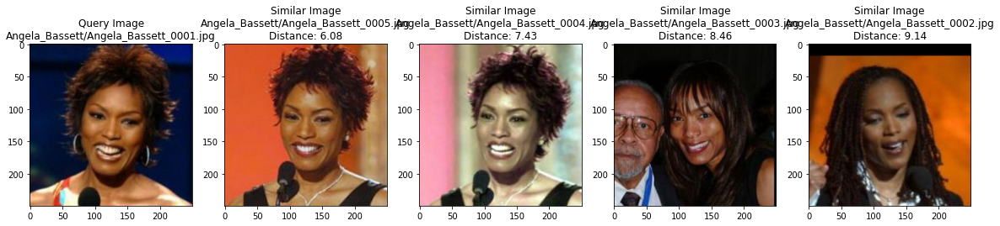

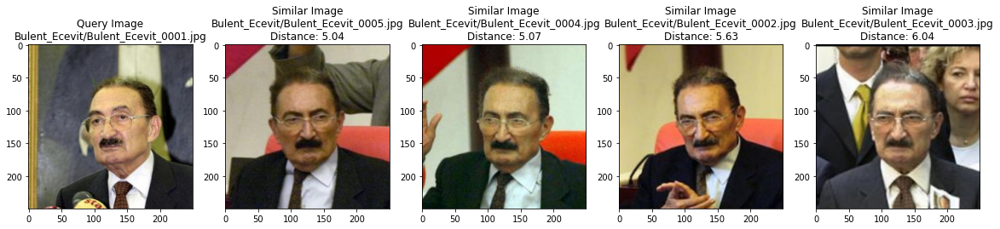

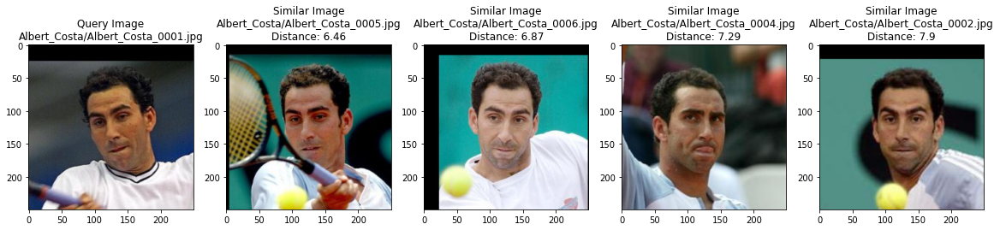

In [ ]:
for i in range(len(test_file_list)):
    detected_faces = extract_face(test_file_list[i])
    embedding = get_embedding(model, detected_faces)
    embedding_compressed = pca.transform([embedding])
    distances, indices = pcaneighbors.kneighbors(embedding_compressed)
    similar_image_paths = [test_file_list[i]] + \
                    [file_list[indices[0][j]] for j in range(1, 5)]
    plot_images(similar_image_paths, distances[0])

In [ ]:
def calculate_accuracy_for_facenet_with_scikit():
    correct_predictions = 0
    incorrect_predictions = 0
    for i in range(len(test_file_list)):
        detected_faces = extract_face(test_file_list[i])
        embedding = get_embedding(model, detected_faces)
        embedding_compressed = pca.transform([embedding])
        distances, indices = pcaneighbors.kneighbors(embedding_compressed)
        
        for j in range(0, number_of_neighbors):
            if (test_labels[i] == classname(
                    file_list[indices[0][j]])):
                correct_predictions += 1
            else:
                incorrect_predictions += 1
    print(
        "Accuracy is ",
        round(
            100.0 * correct_predictions /
            (1.0 * correct_predictions + incorrect_predictions), 2))

In [ ]:
calculate_accuracy_for_facenet_with_scikit()

Accuracy is  78.0


### **Similarity Search : FAISS**

1.   FAISS or Facebook AI Similarity Search is a library written in the C++ language with GPU support. It also has Python bindings so that it can be used with Numpy, Pandas, and other Python-based libraries. 
2.    Its algorithmic enhancements that vastly narrow down the search space for a vector’s k-nearest neighbours allow it to have a much faster similarity search between vectors as compared to existing libraries like Scikit Learn. This technique is called Approximate Nearest Neighbours (ANN) search and sacrifices some precision to obtain the vast speedups.



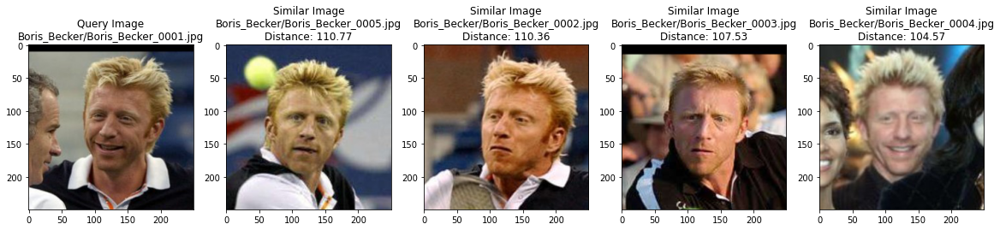

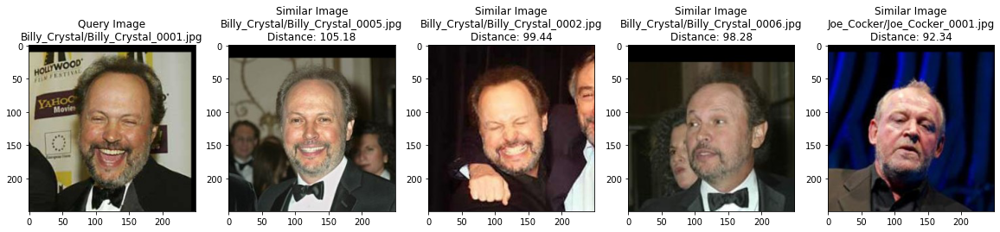

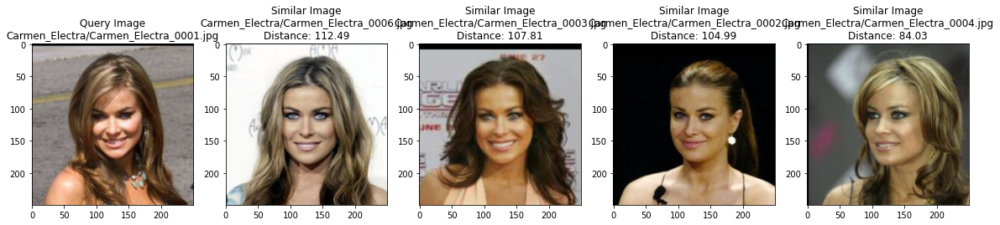

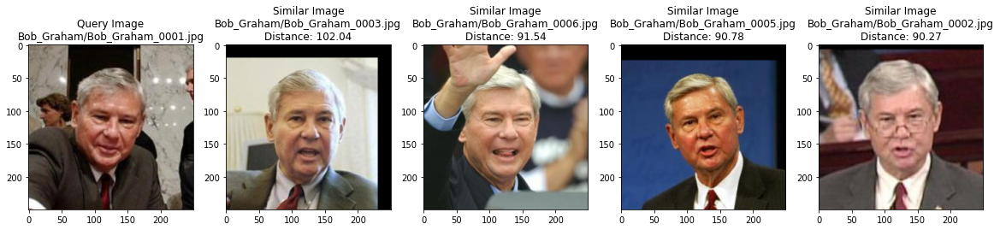

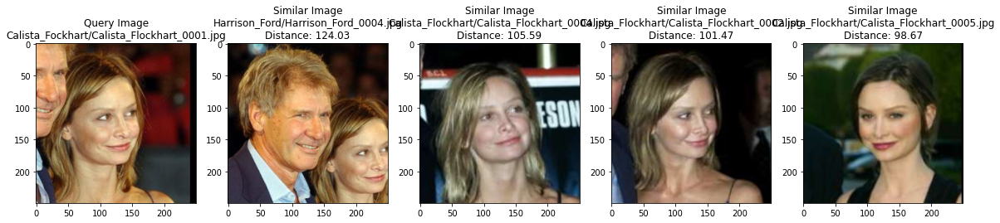

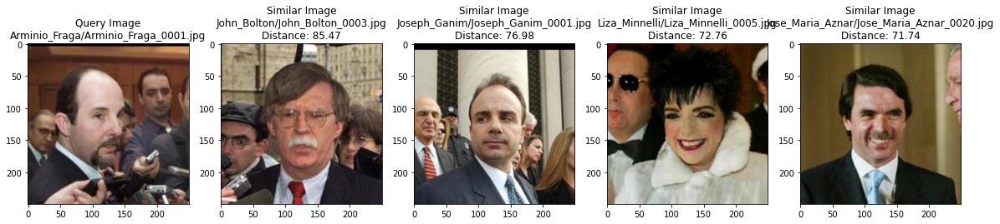

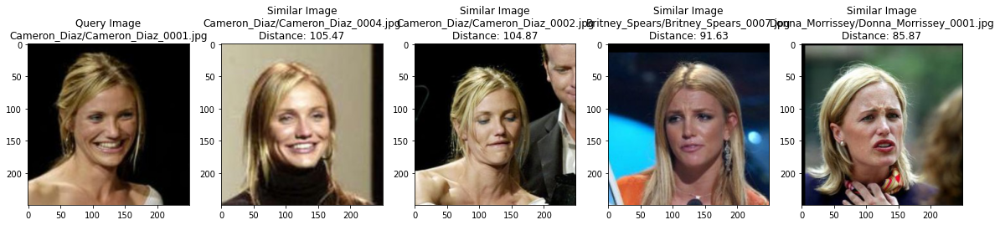

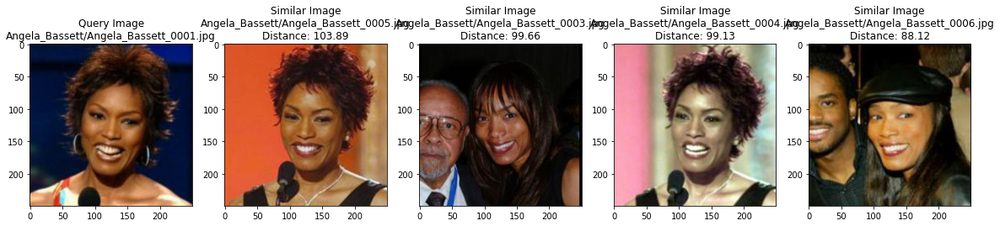

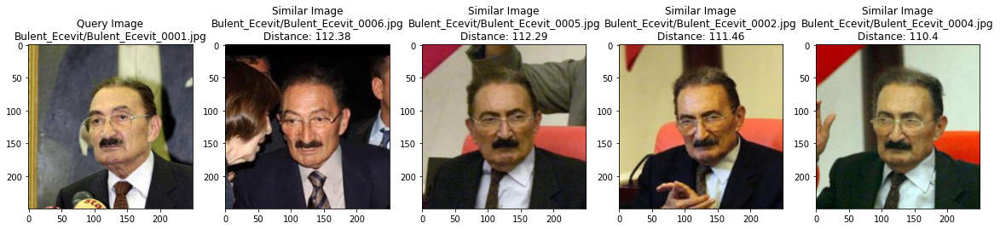

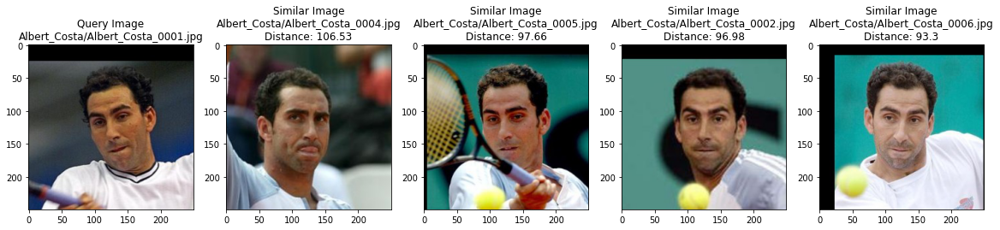

In [ ]:
index = faiss.IndexFlatIP(128)
faiss.normalize_L2(np.array(standard_feature_list))
index.add(np.array(standard_feature_list))
for i in range(len(test_file_list)):
    embedding = []
    detected_faces = extract_face(test_file_list[i])
    embedding.append(get_embedding(model, detected_faces))
    distances, indices = index.search(np.array(embedding), k=number_of_neighbors)
    similar_image_paths = [test_file_list[i]] + \
                    [file_list[indices[0][j]] for j in range(1, 5)]
    plot_images(similar_image_paths, distances[0])

In [ ]:
def calculate_accuracy_for_facenet_with_faiss():
    correct_predictions = 0
    incorrect_predictions = 0
    for i in range(len(test_file_list)):
        embedding = []
        detected_faces = extract_face(test_file_list[i])
        embedding.append(get_embedding(model, detected_faces))
        distances, indices = index.search(np.array(embedding), k=number_of_neighbors)
        
        for j in range(0, number_of_neighbors):
            if (test_labels[i] == classname(
                    file_list[indices[0][j]])):
                correct_predictions += 1
            else:
                incorrect_predictions += 1
    print(
        "Accuracy is ",
        round(
            100.0 * correct_predictions /
            (1.0 * correct_predictions + incorrect_predictions), 2))
calculate_accuracy_for_facenet_with_faiss()

Accuracy is  76.0


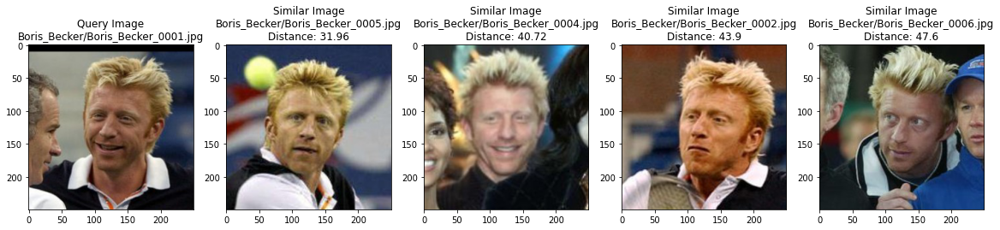

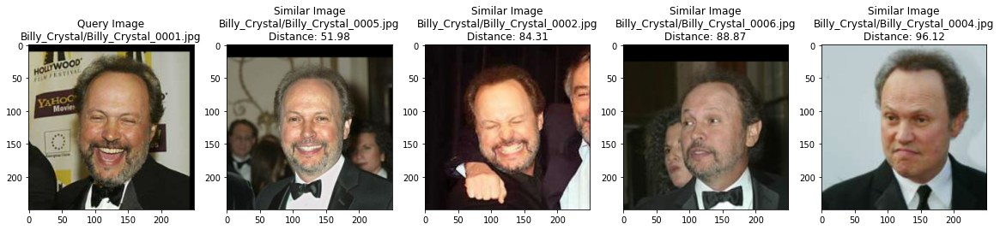

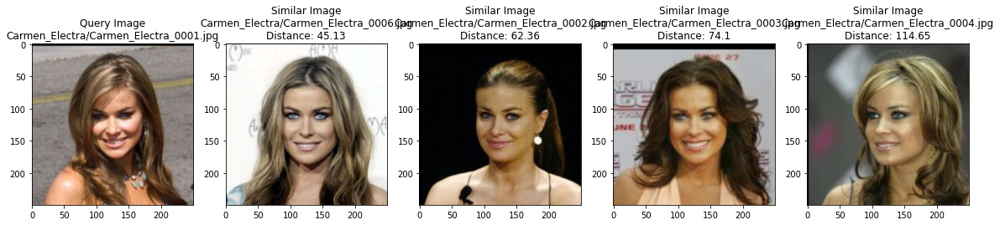

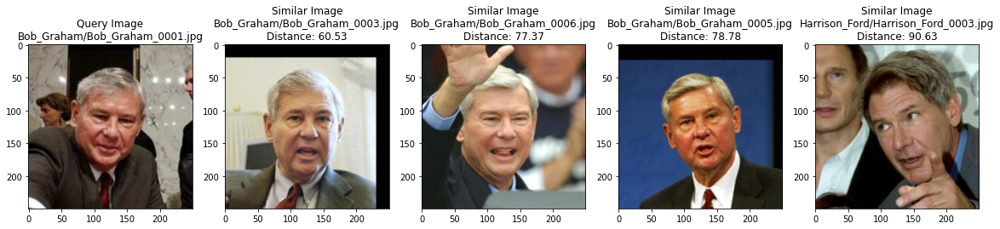

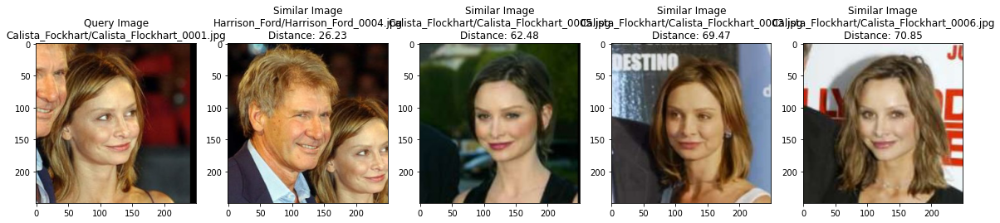

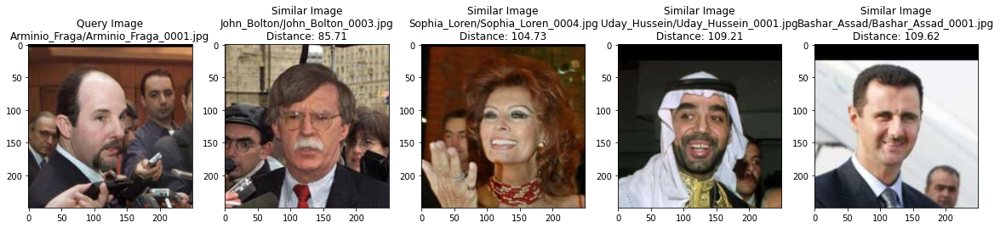

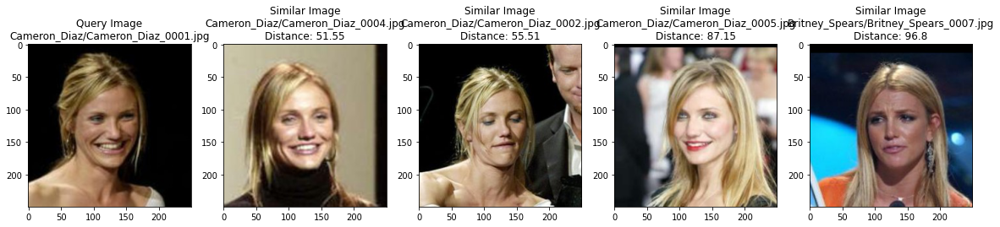

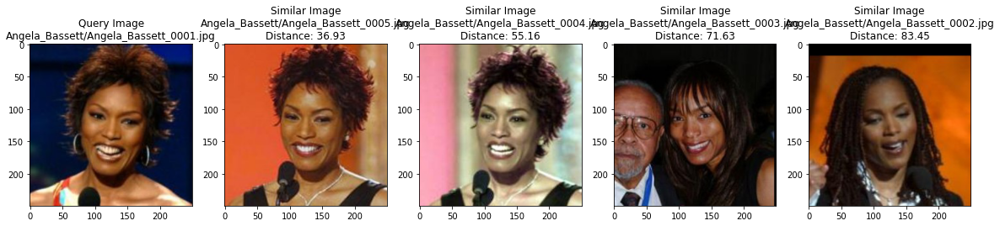

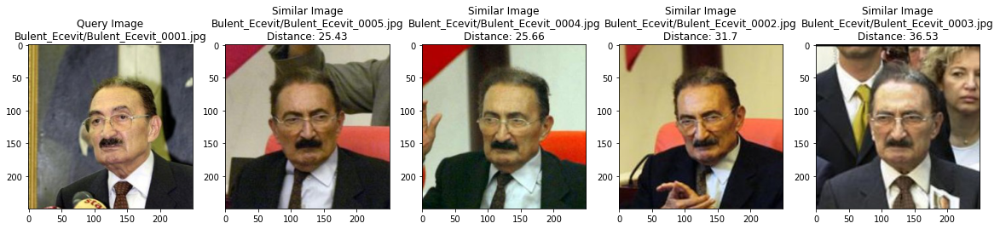

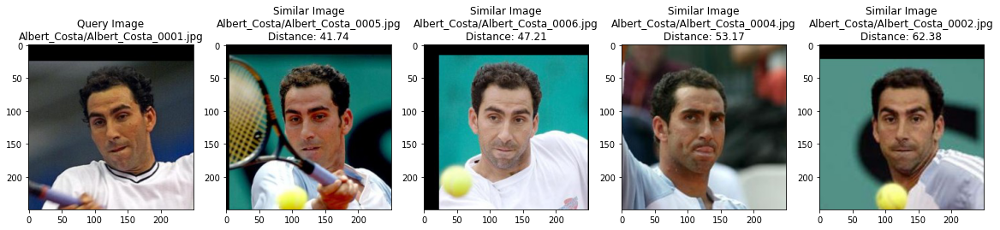

In [ ]:
quantizer = faiss.IndexFlatL2(128)
index = faiss.IndexIVFFlat(quantizer, 128, NUM_CLASSES)
index.nprobe = number_of_neighbors
index.train(np.array(standard_feature_list))
index.add(np.array(standard_feature_list))
for i in range(len(test_file_list)):
    embedding = []
    detected_faces = extract_face(test_file_list[i])
    embedding.append(get_embedding(model, detected_faces))
    distances, indices = index.search(np.array(embedding), k=number_of_neighbors)
    similar_image_paths = [test_file_list[i]] + \
                    [file_list[indices[0][j]] for j in range(1, 5)]
    plot_images(similar_image_paths, distances[0])

In [ ]:
calculate_accuracy_for_facenet_with_faiss()

Accuracy is  78.0


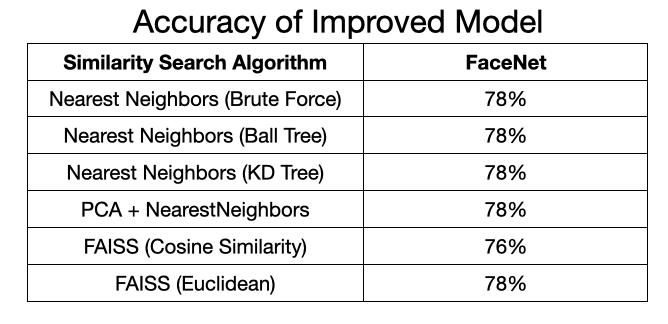